**IMPORT LIBRARIES**

In [ ]:
import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt
from math import sin
from scipy import signal

In [ ]:
import warnings
warnings.filterwarnings('ignore')

#### 2-Component

##### **FIRST VERSION**

$\frac{dC}{dt} = k1 \cdot C \cdot \sin\left(\frac{kdc^p}{kdc^p + W \cdot (t - teta)^p}\right) - \cos(kc \cdot Ec)$


$\frac{dW}{dt} = k2 \cdot W \cdot \cos\left(\frac{kdw^p}{kdw^p + C \cdot (t - teta)^p}\right) - \sin(kw \cdot Ew)$


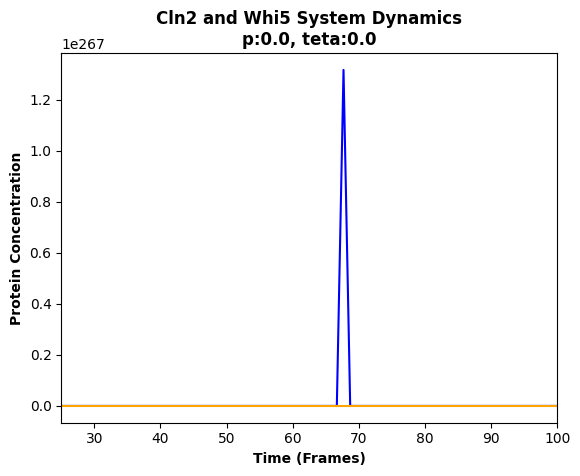

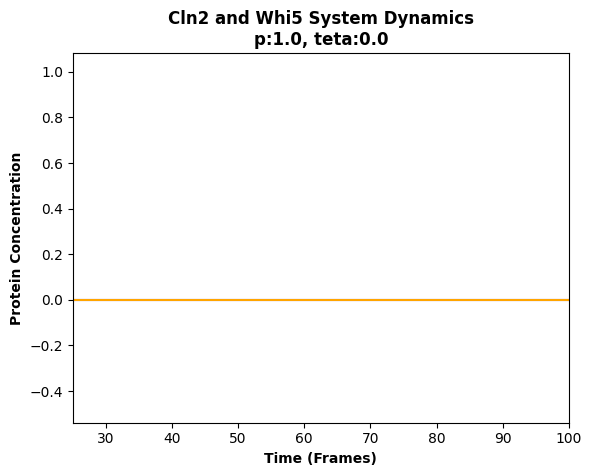

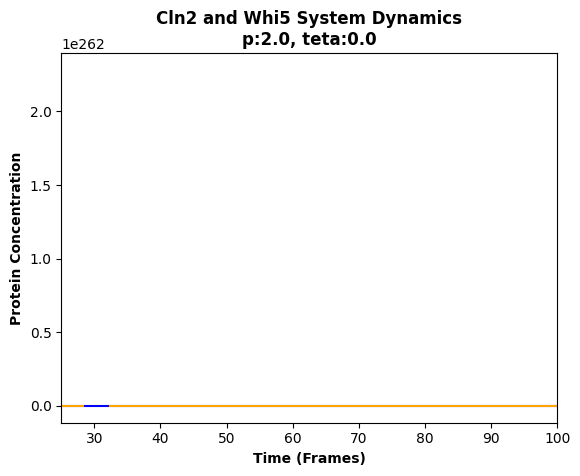

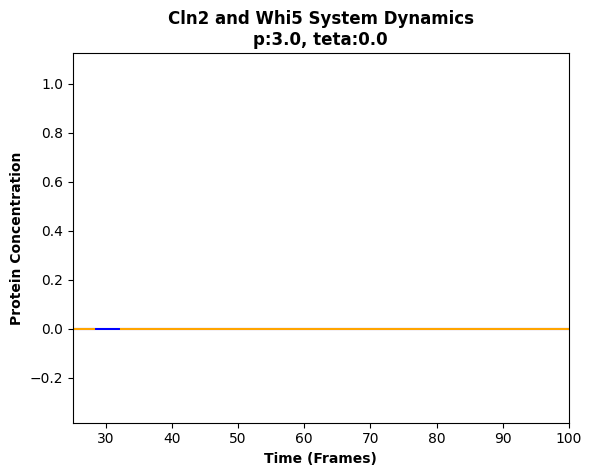

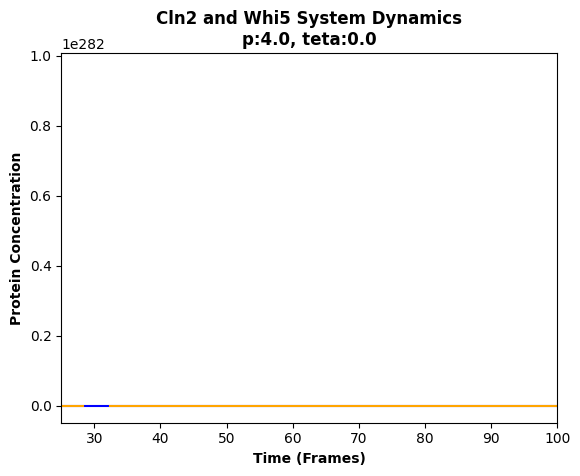

...

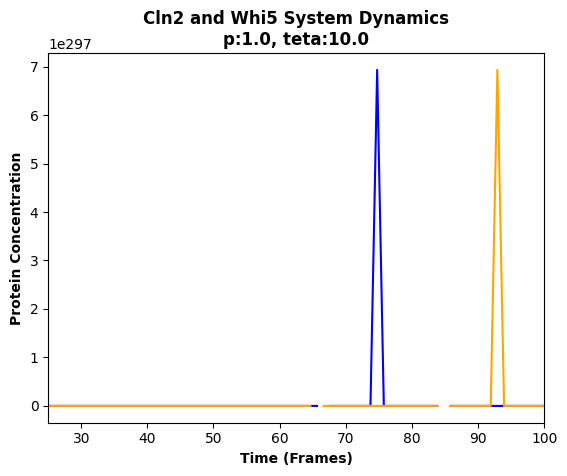

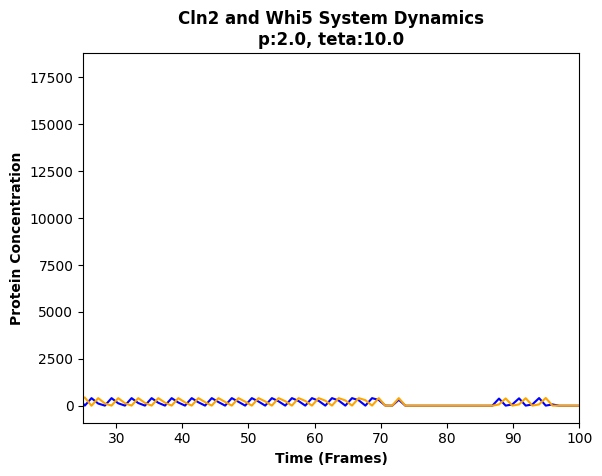

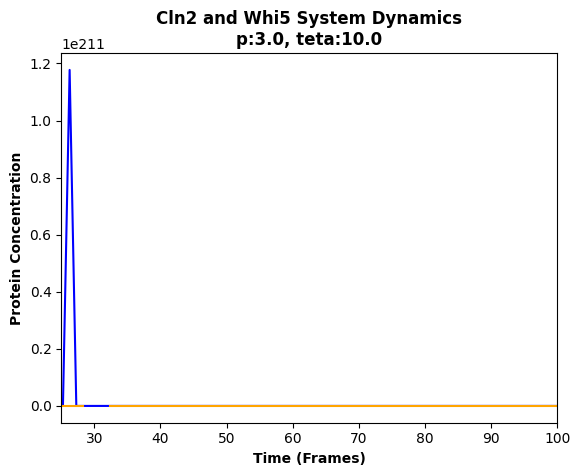

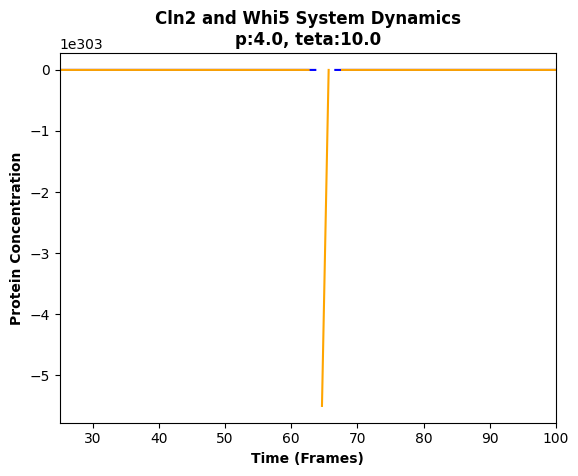

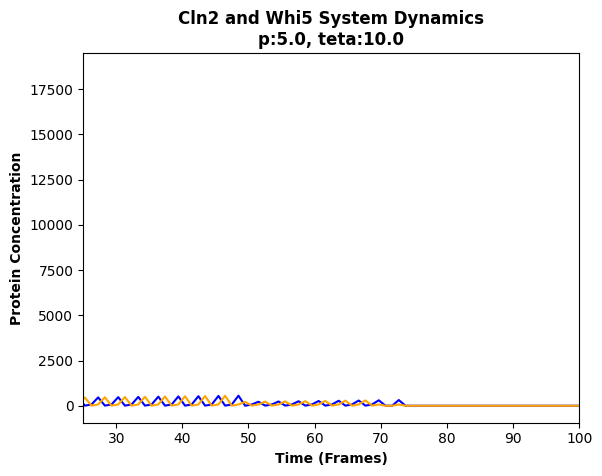

In [ ]:
#Define the function which contains the set of ordinary differential equations to mathematically model Whi5 and Cln2 interaction
def two_components_first(y, t, k1, k2, kdc, kc, Ec, kdw, kw, Ew, p, teta):
    C, W = y

    dCdt = k1*C * np.sin((kdc**p / (kdc**p + W*(t - teta)**p))) - np.cos(kc*Ec)
    dWdt = k2*W * np.cos((kdw**p / (kdw**p + C*(t - teta)**p))) - np.sin(kw*Ew)

    return [dCdt, dWdt]

# Define the function parameters
k1, k2, kdc, kc, Ec, kdw, kw, Ew, p, teta, km1, km2 = [ 1, 1, 0.2, 0.1, 1, 0.2, 0.1, 1, 2, 6, 1, 1]

# Define the time points to evaluate the solution and the initial conditions y0=[C0, W0]
t = np.linspace(0, 100, 100)
y0 = [0.0, 1.0]

# Solve the function taking into account different values of teta and p, the ode system is solved using the odeint function
for teta in np.linspace(0, 10, 11):
  for p in np.linspace(0, 5, 6):
    sol = odeint(two_components_first, y0, t, args=(k1, k2, kdc, kc, Ec, kdw, kw, Ew, p, teta))

    # Extract the solutions for C and W
    C = sol[:, 0]
    W = sol[:, 1]

    # Plot the results
    plt.xlabel('Time (Frames)', weight='bold')
    plt.ylabel('Protein Concentration', weight='bold')
    plt.plot(t, C, label='C', c='blue')
    plt.plot(t, W, label='W', c='orange')
    plt.xlim(25, 100)
    plt.title('Cln2 and Whi5 System Dynamics\np:{}, teta:{}'.format(p, teta), weight='bold')
    plt.show()


##### **SECOND VERSION**

$\frac{dC}{dt} = \alpha \cdot \left(\frac{k1 \cdot \exp(-kdc \cdot t)}{1 + W \cdot \sin(teta - t)^p}\right) - kc \cdot Ec \cdot \cos(\alpha \cdot t)$


$\frac{dW}{dt} = \alpha \cdot \left(\frac{k2 \cdot \exp(-kdw \cdot t)}{1 + C \cdot \cos(teta - t)^p}\right) - kw \cdot Ew \cdot \sin(\alpha \cdot t)$

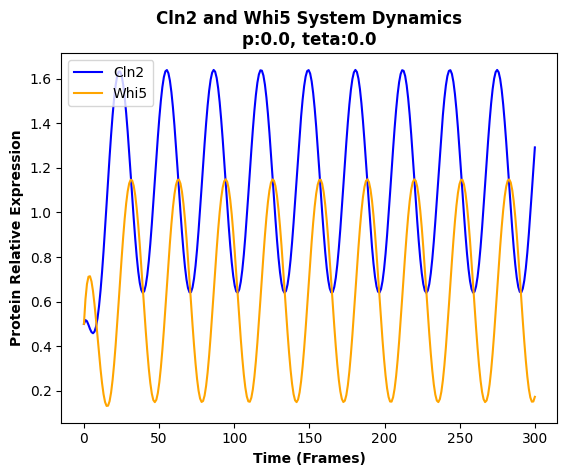

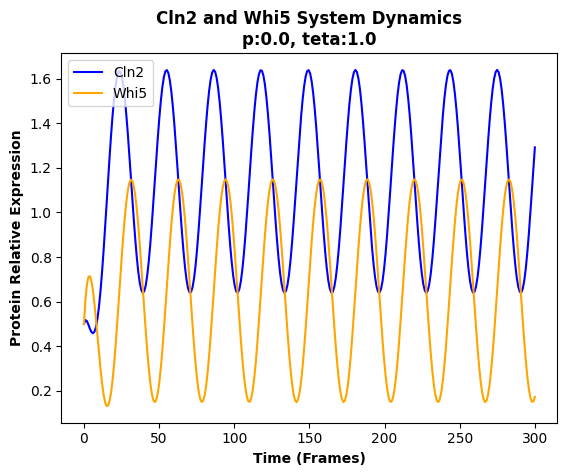

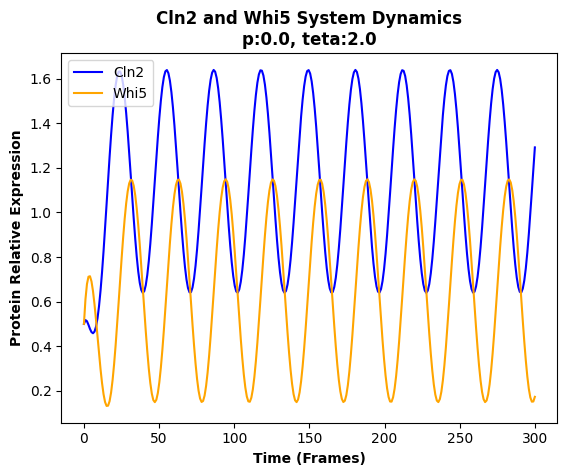

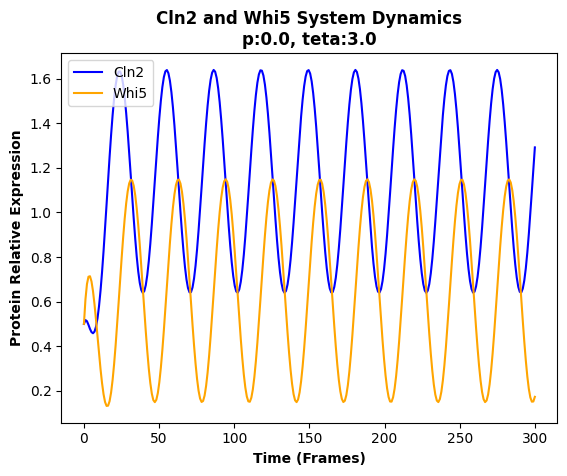

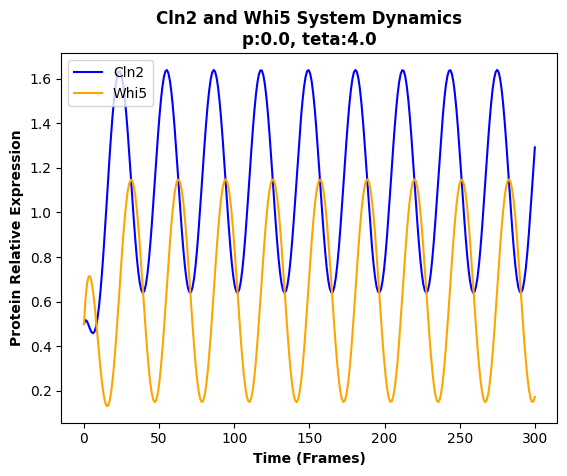

...

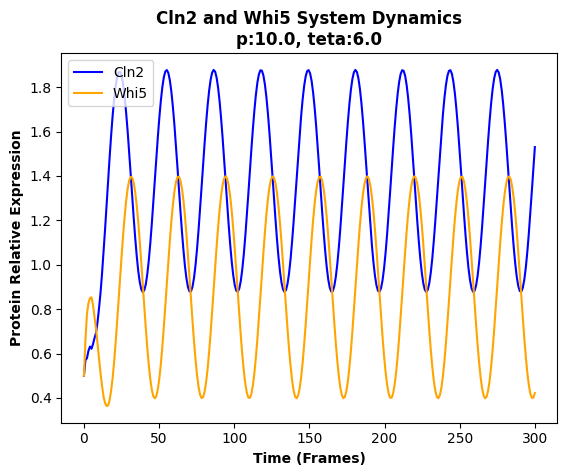

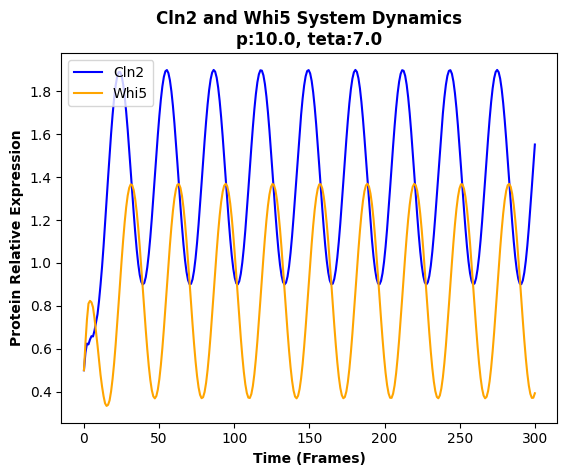

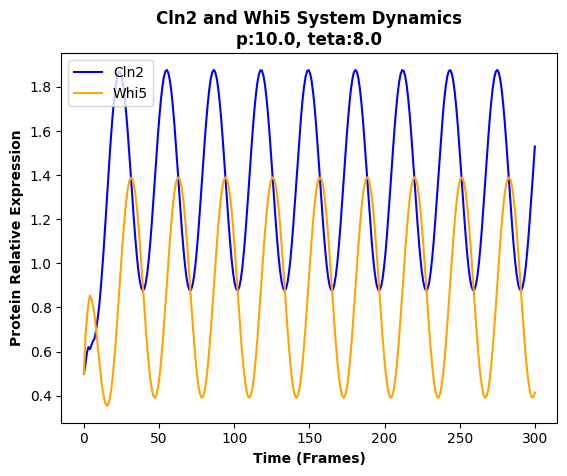

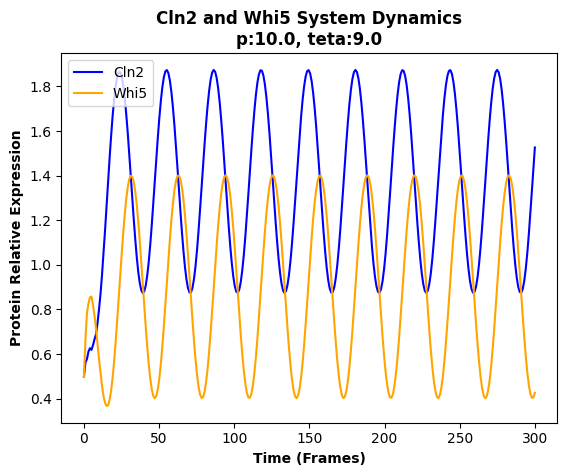

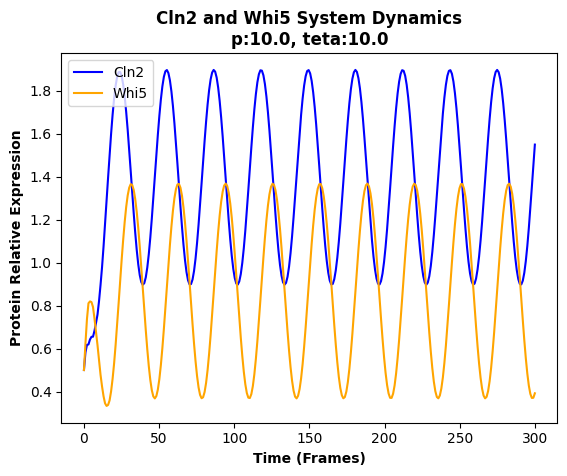

In [ ]:
#Define the function which contains the set of ordinary differential equations to mathematically model Whi5 and Cln2 interaction

def two_components_second(y, t, k1, k2, kdc, kc, Ec, kdw, kw, Ew, p, teta, alpha):

    C, W = y

    dCdt = alpha * (k1 * np.exp(-kdc * t) / (1 + W * np.sin(teta - t)**p)) - kc * Ec * np.cos(alpha * t)
    dWdt = alpha * (k2 * np.exp(-kdw * t) / (1 + C * np.cos(teta - t)**p)) - kw * Ew * np.sin(alpha * t)

    return [dCdt, dWdt]

# Define the function parameters
k1, k2, kdc, kc, Ec, kdw, kw, Ew, p, teta, alpha = [1, 1, 0.2, 0.1, 1, 0.2, 0.1, 1, 2, 4, 0.2]

# Define the time points to evaluate the solution and the initial conditions y0=[C0, W0]
t = np.linspace(0, 300, 300)
y0 = [0.5, 0.5]

# Solve the function taking into account different values of teta and p, the ode system is solved using the odeint function
for p in np.linspace(0, 10, 11):
  for teta in np.linspace(0, 10, 11):

    sol = odeint(two_components_second, y0, t, args=(k1, k2, kdc, kc, Ec, kdw, kw, Ew, p, teta, alpha))

    #Extract the solutions for C and W
    C = sol[:, 0]
    W = sol[:, 1]

    #Plot only those signals which are lower than 3, this is a filter I am applying after seeing all the data

    if np.all(C < 3) and np.all(W < 3):

      # Plot the results
      plt.xlabel('Time (Frames)', weight='bold')
      plt.ylabel('Protein Relative Expression', weight='bold')

      plt.plot(t, C, label='Cln2', c='blue')
      plt.plot(t, W, label='Whi5', c='orange')

      plt.legend()

      plt.title('Cln2 and Whi5 System Dynamics\np:{}, teta:{}'.format(p, teta), weight='bold')

      plt.show()


#### 3-COMPONENT

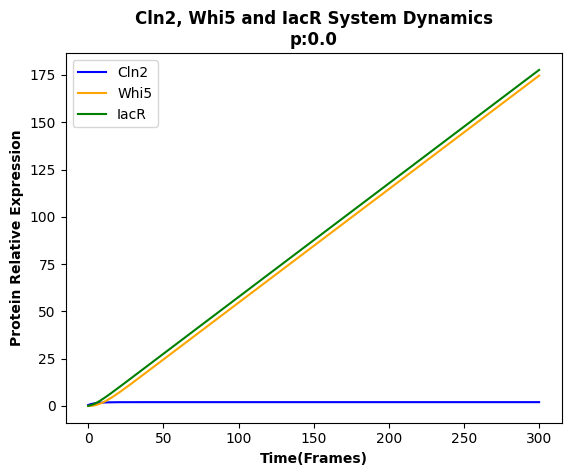

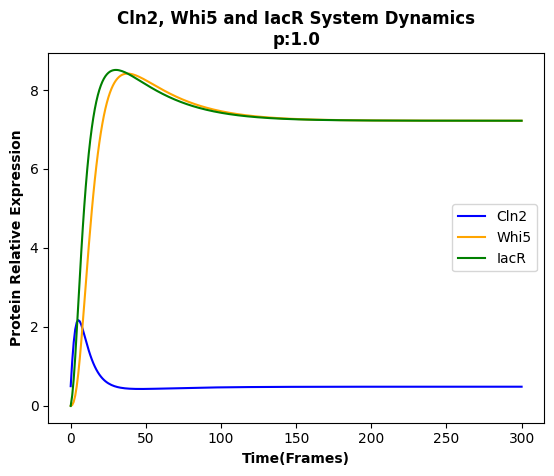

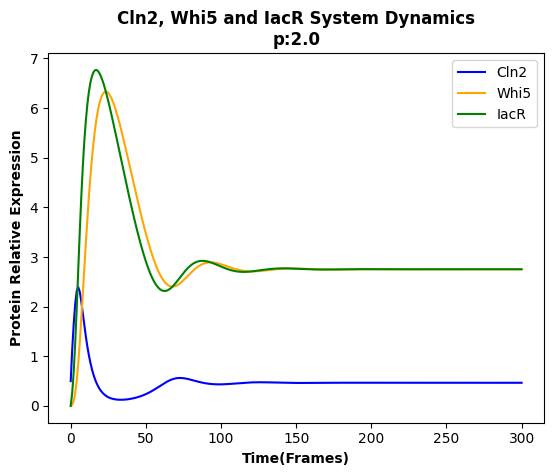

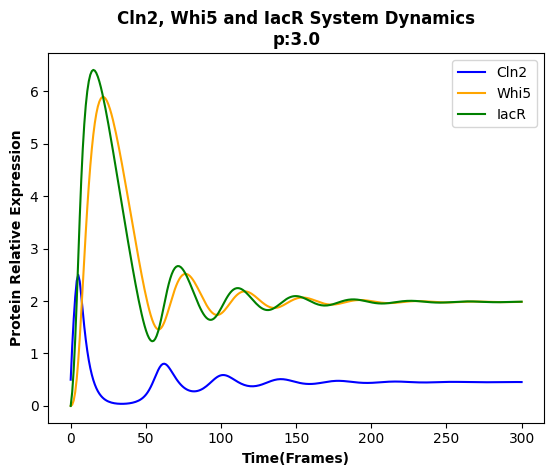

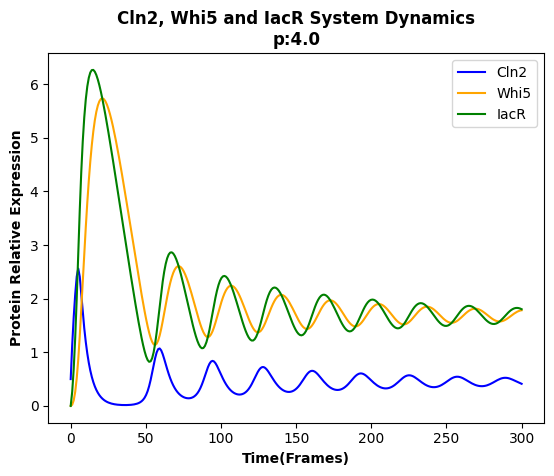

...

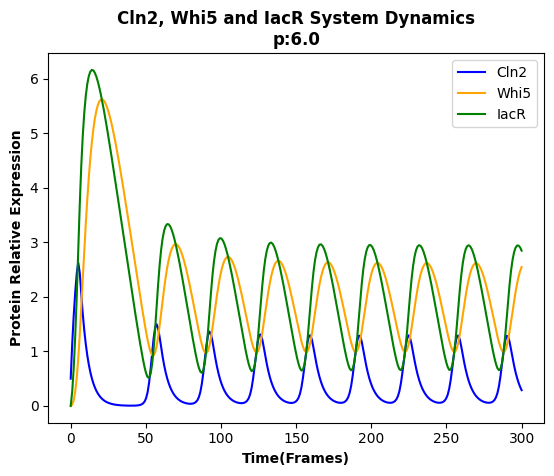

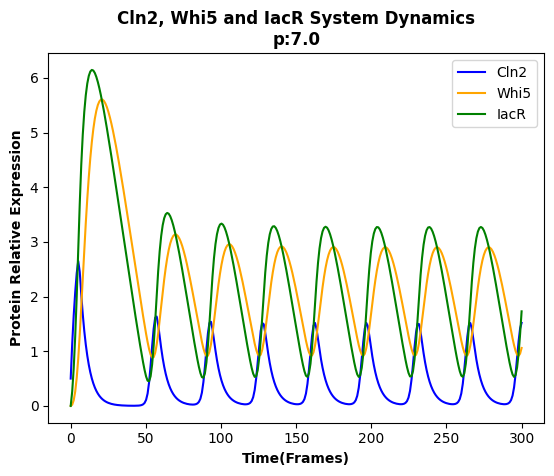

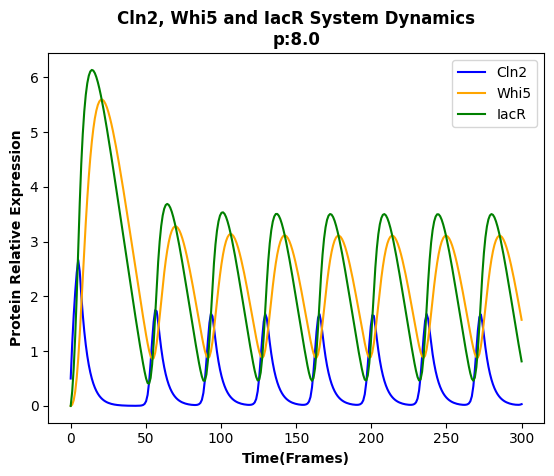

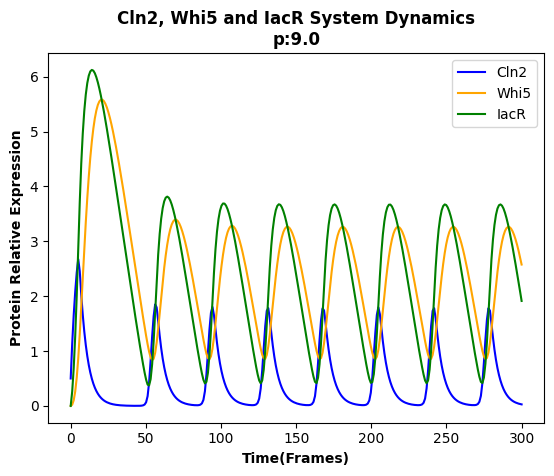

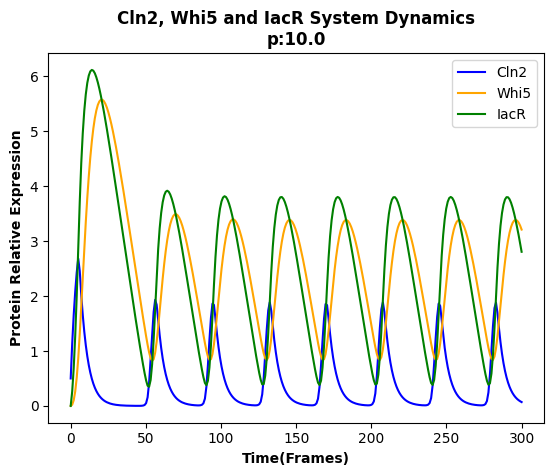

In [ ]:
#Define the function which contains the set of ordinary differential equations to mathematically model Whi5, Cln2 and IacR interaction

def three_component(y, t, k1, k2, k3, k4, k5, km, S, p):

    C, W, I = y

    dCdt= k1*S/(1+(W**p)) -k2*C
    dIdt= k3*C -k4*I/(km +I)
    dWdt= k5*(I-W)

    return [dCdt, dWdt, dIdt]

# Define the function parameters
k1, k2, k3, k4, k5, km, S, p = [0.2, 0.2, 0.4, 0.2, 0.2, 0.2, 4, 8]

# Define the time points to evaluate the solution and the initial conditions y0=[C0, W0, I0]
t = np.linspace(0, 300, 300)
y0 = [0.5, 0, 0]

# Solve the function taking into account different values of p, the ode system is solved using the odeint function

for p in np.linspace(0, 10, 11):
  sol = odeint(three_component, y0, t, args=(k1, k2, k3, k4, k5, km, S, p))

  # Extract the solutions for C, W, I
  C = sol[:, 0]
  W = sol[:, 1]
  I = sol[:, 2]

  # Plot the results
  plt.plot(t, C, label='Cln2', c='blue')
  plt.plot(t, W, label='Whi5', c='orange')
  plt.plot(t, I, label='IacR', c='green')

  plt.xlabel('Time(Frames)', weight='bold')
  plt.ylabel('Protein Relative Expression', weight='bold')

  plt.title('Cln2, Whi5 and IacR System Dynamics\np:{}'.format(p), weight='bold')

  plt.legend()

  plt.show()

#### 4-COMPONENT

##### First Equation

$\frac{dC}{dt} = \frac{k1 \cdot S}{1 + W^p} - k2 \cdot C$


$\frac{dI}{dt} = \frac{k3 \cdot C}{1 + A \cdot I \cdot ka} - k4 \cdot I$


$\frac{dW}{dt} = k5 \cdot (I \cdot A \cdot ka - W)$


$\frac{dA}{dt} = \sin\left(\frac{2 \pi t}{\text{square_wave_period}} + \text{phase_shift}\right) \cdot 0.5$

**Depending on IacR-IAA affinity**

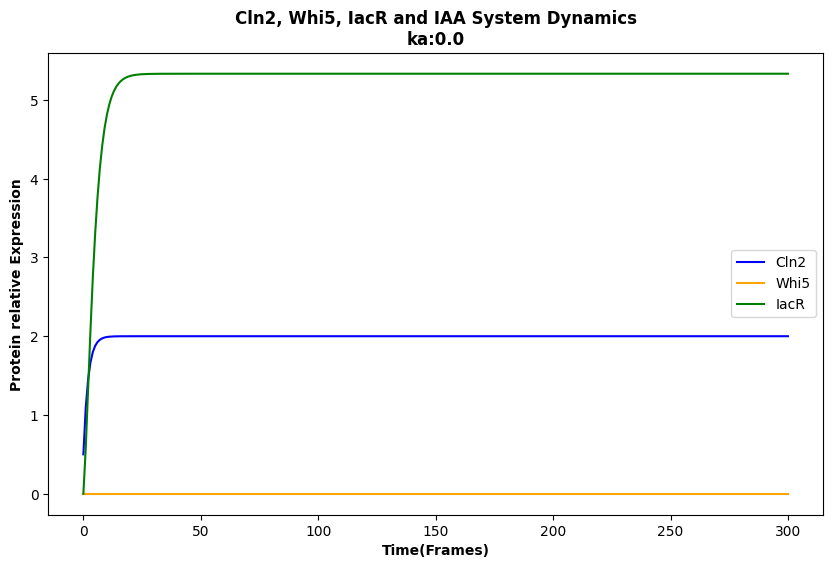

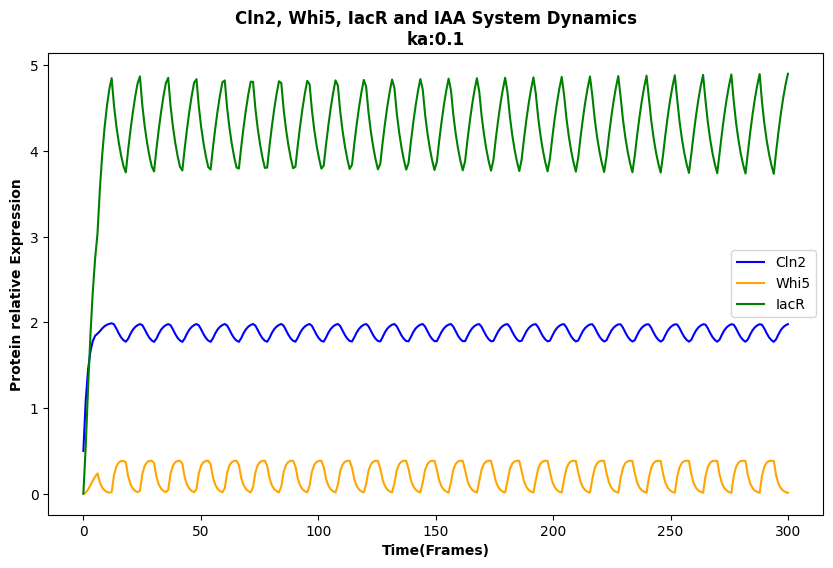

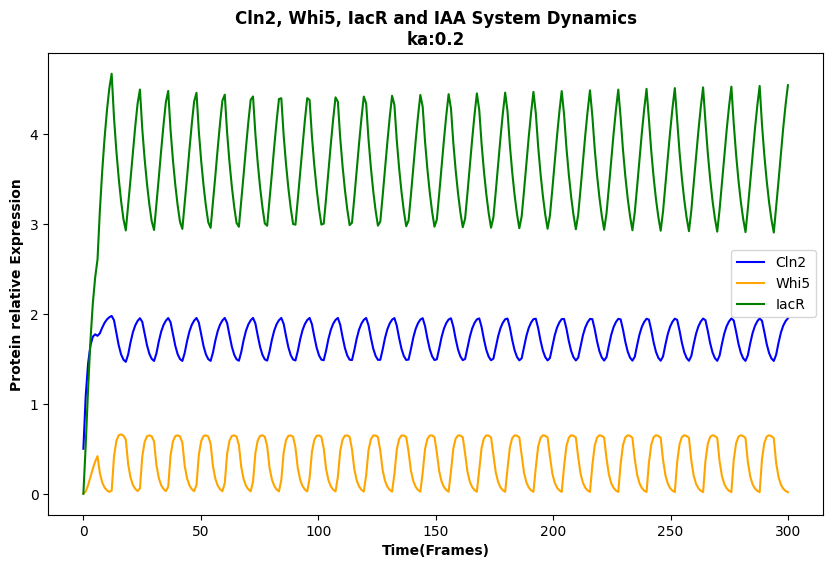

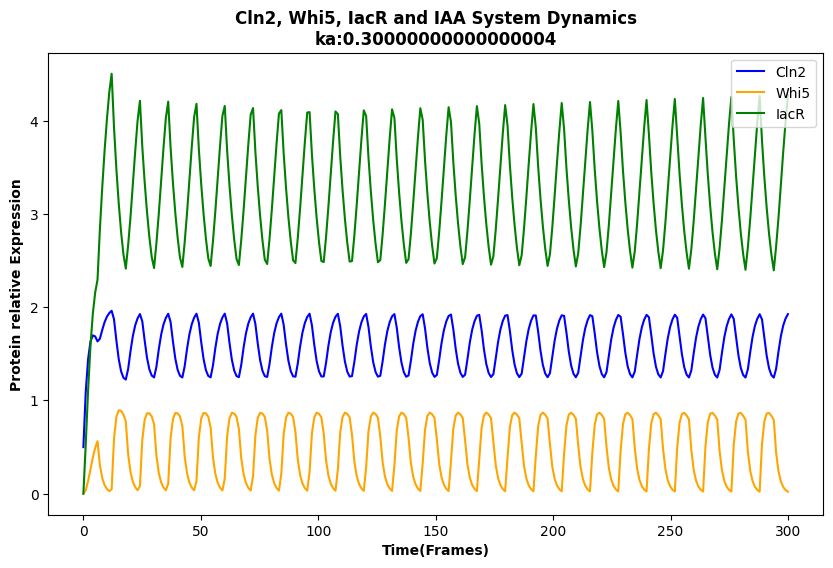

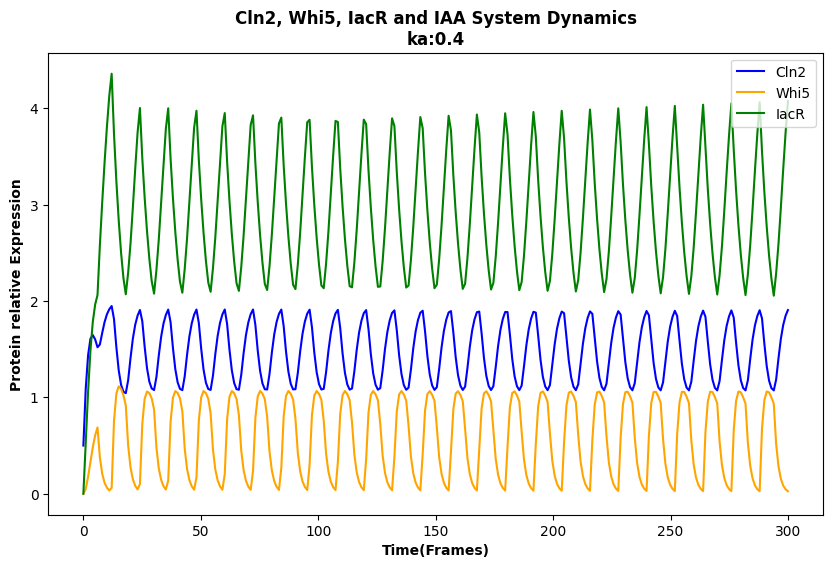

...

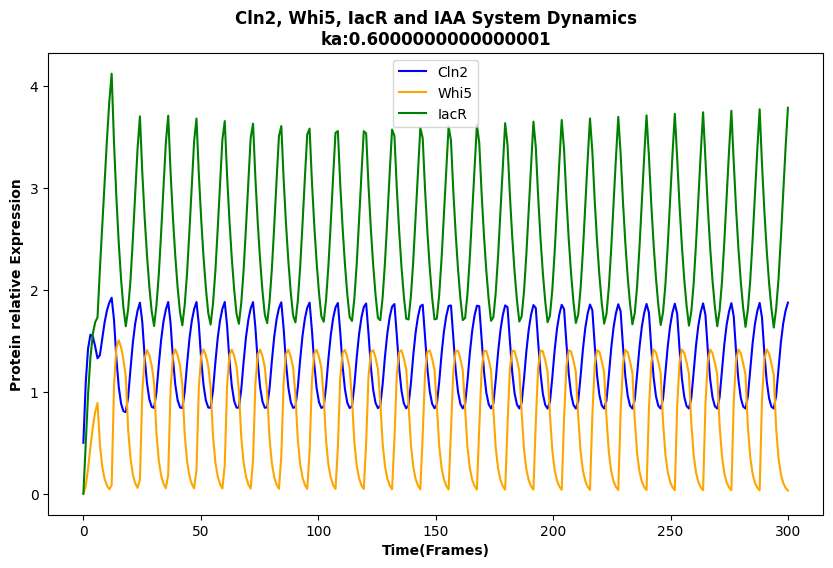

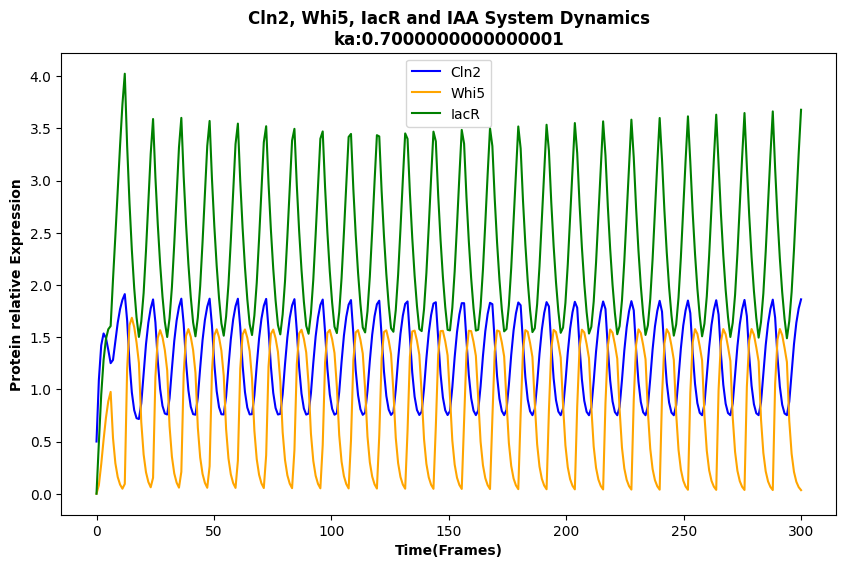

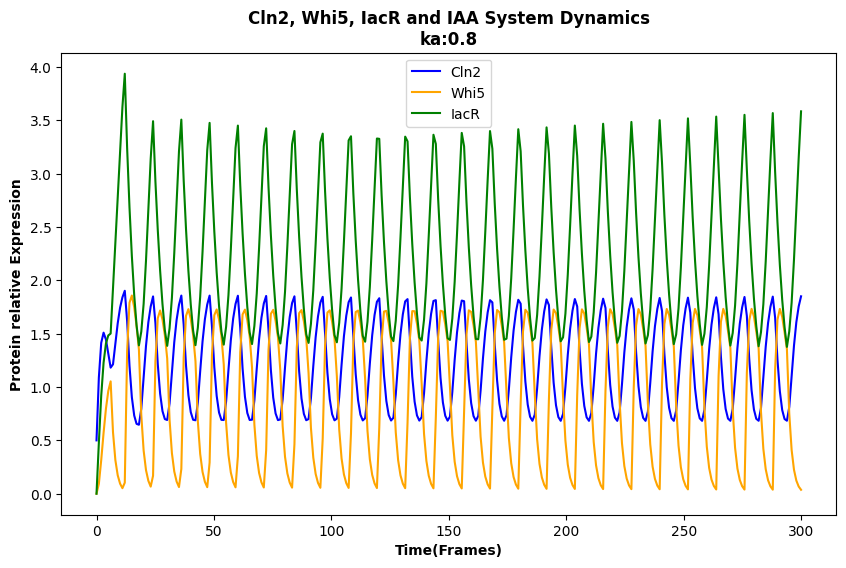

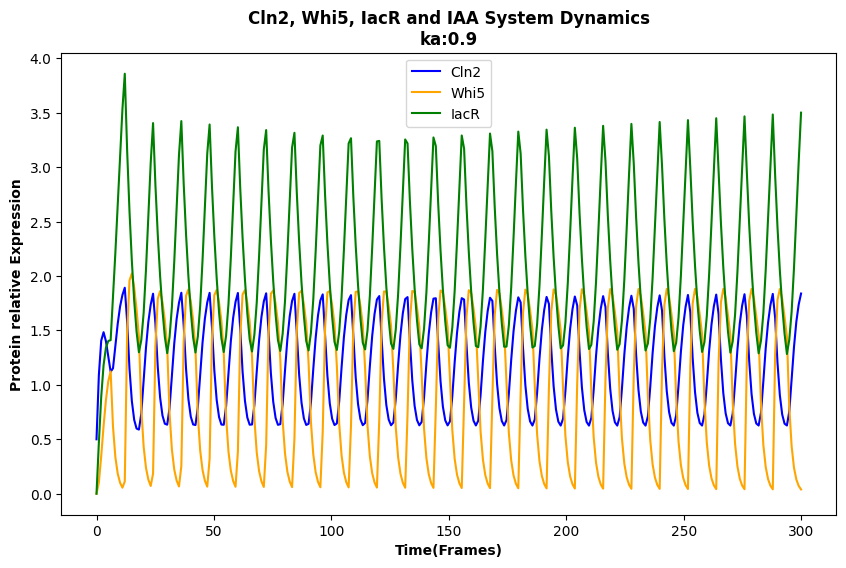

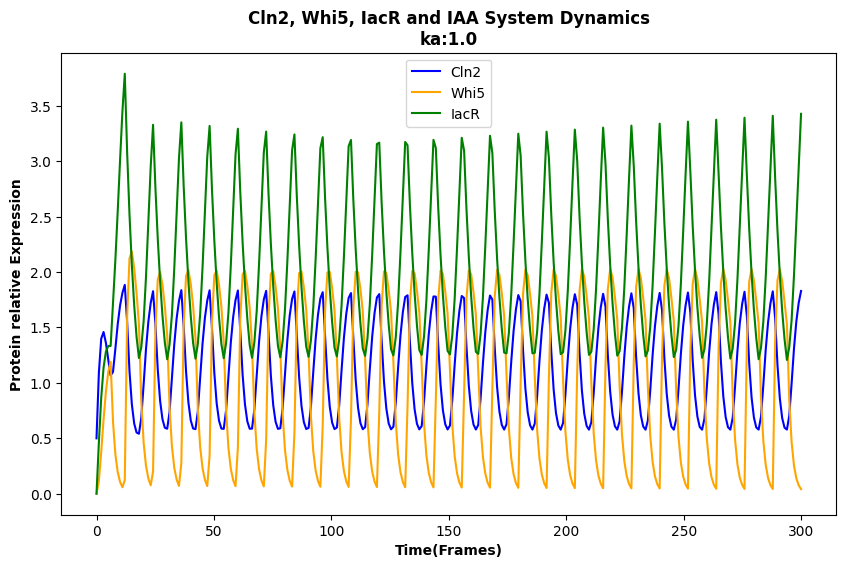

In [ ]:
#Define the function which contains the set of ordinary differential equations to mathematically model Whi5, Cln2, IacR and IAA interaction

def four_component_first(y, t, k1, k2, k3, k4, k5, km, ka, S, p, square_wave_period, phase_shift):

    #Compute the auxin signalling
    A = 0.5 * (np.sign(np.sin(2 * np.pi * t / square_wave_period)) + 1)

    #Start defining the ODEs
    C, W, I= y

    dCdt = k1 * S / (1 + (W ** p)) - k2 * C
    dIdt = k3 * C / (1 + (A*I * ka)) - k4  * I
    dWdt = k5 * (I * A* ka - W)

    return [dCdt, dWdt, dIdt]

# Define the function parameters
k1, k2, k3, k4, k5, km, ka, S, p, square_wave_period = [1.0, 0.5, 0.8, 0.3, 0.6, 0.1, 0.2, 1.0, 2.0, 12]
phase_shift= np.pi / 4

# Define the time points to evaluate the solution and the initial conditions y0=[C0, W0, I0, A0]
t = np.linspace(0, 300, 300)
y0 = [0.5, 0.0, 0.0]

# Solve the function taking into account different values of ka, the ode system is solved using the odeint function
for ka in np.linspace(0, 1, 11):

    sol = odeint(four_component_first, y0, t, args=(k1, k2, k3, k4, k5, km, ka, S, p, square_wave_period, phase_shift))

    # Extract the solutions for C, W, I and A
    C = sol[:, 0]
    W = sol[:, 1]
    I = sol[:, 2]

    # Plot the results

    plt.figure(figsize=(10, 6)) #set figure size
    plt.plot(t, C, label='Cln2', c='blue')
    plt.plot(t, W, label='Whi5', c='orange')
    plt.plot(t, I, label='IacR', c='green')


    plt.ylabel('Protein relative Expression', weight='bold')
    plt.xlabel('Time(Frames)', weight='bold')


    plt.title('Cln2, Whi5, IacR and IAA System Dynamics\nka:{}'.format(ka), weight='bold')

    plt.legend()

    plt.show()

##### Second equation

$\frac{dC}{dt} = \frac{k1 \cdot S}{1 + W^p} - k2 \cdot C$


$\frac{dI}{dt} = \frac{k3 \cdot C}{1 + I \cdot ka} - k4 \cdot I \cdot A$


$\frac{dW}{dt} = k5 \cdot (I - W)$


$\frac{dA}{dt} = \sin\left(\frac{2 \pi t}{\text{square_wave_period}} + \text{phase_shift}\right) \cdot 0.5$

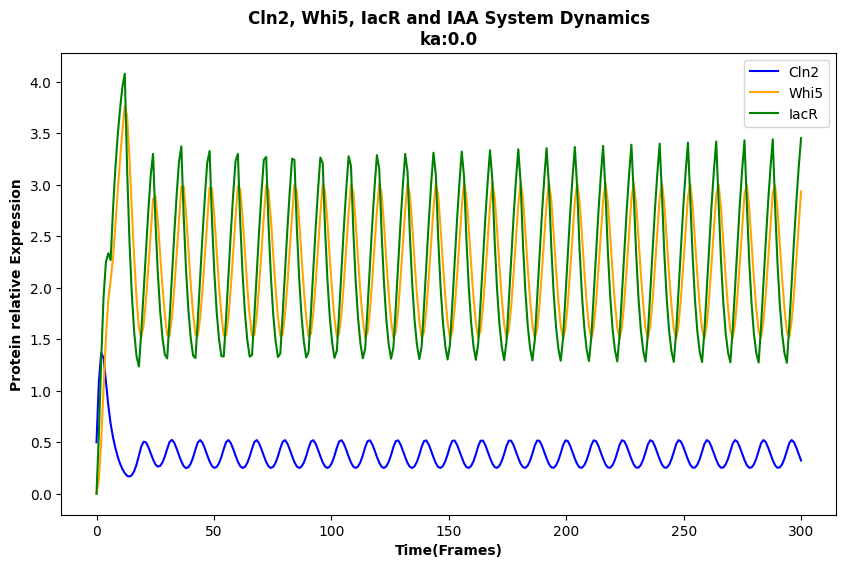

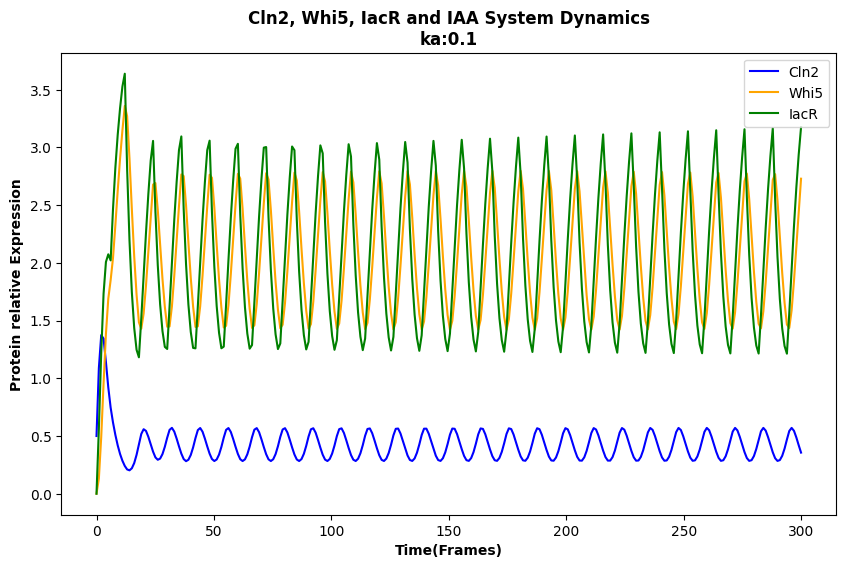

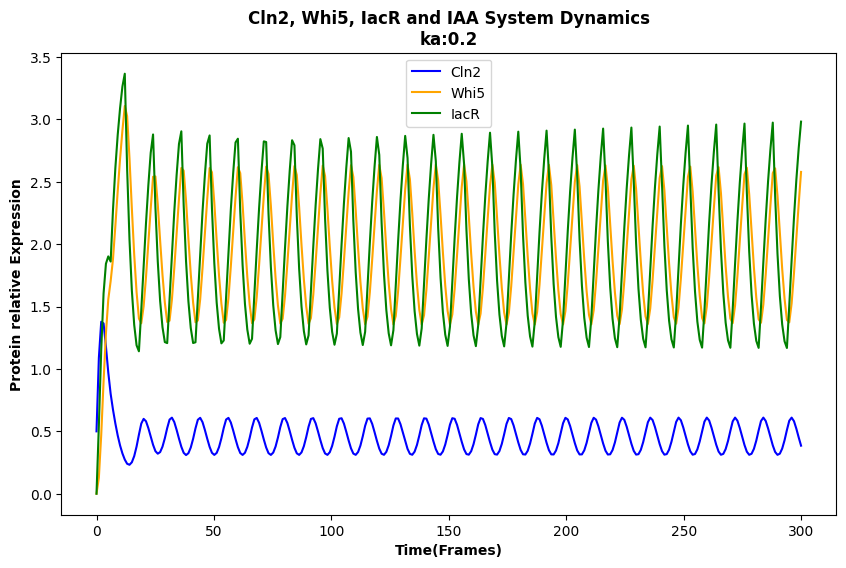

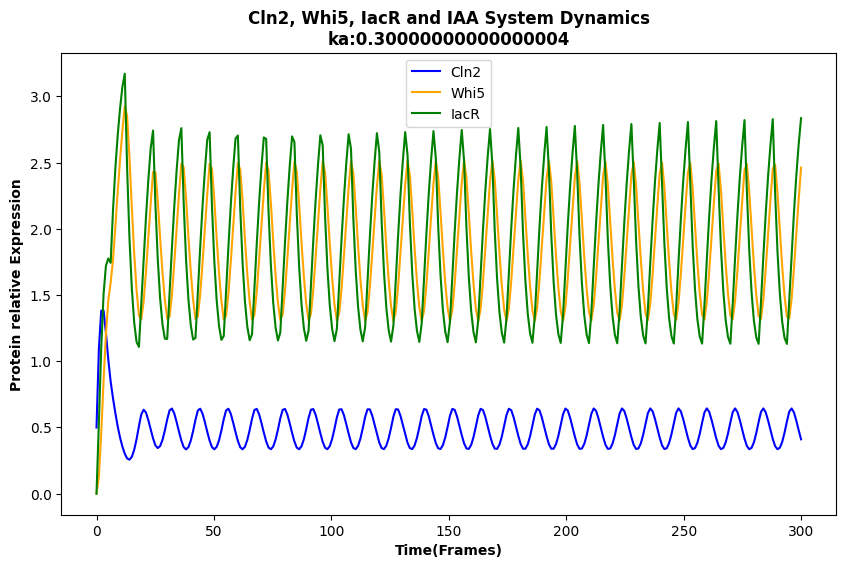

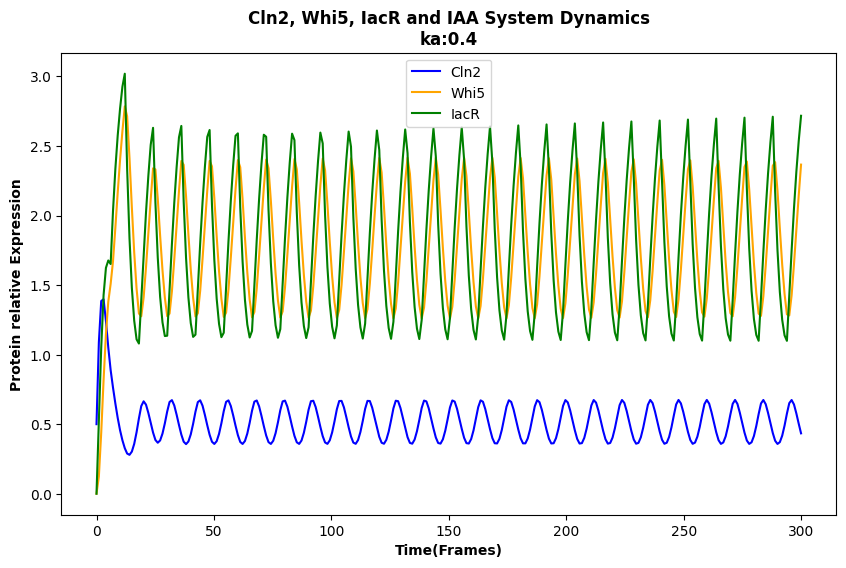

...

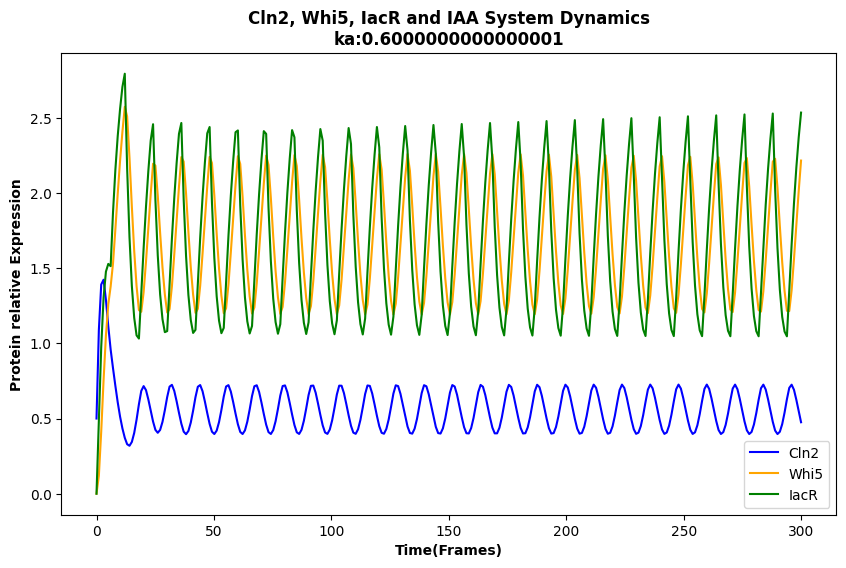

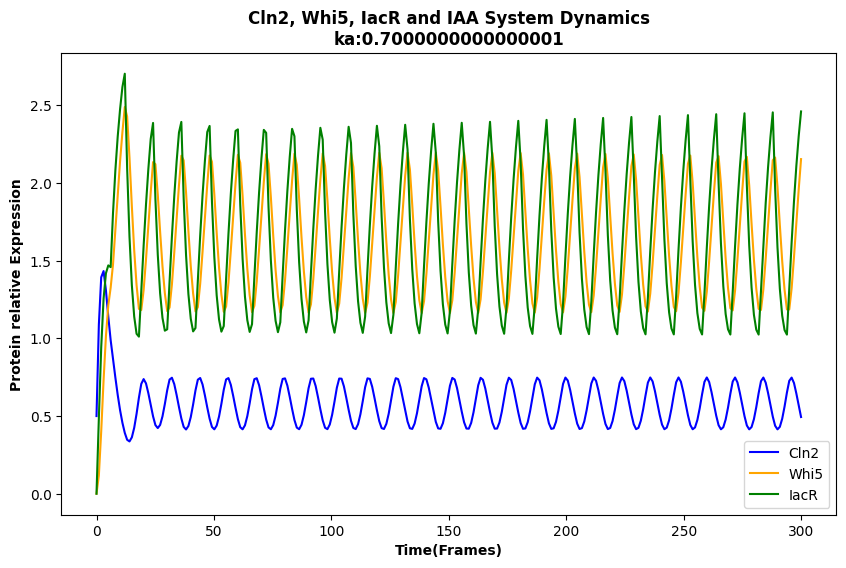

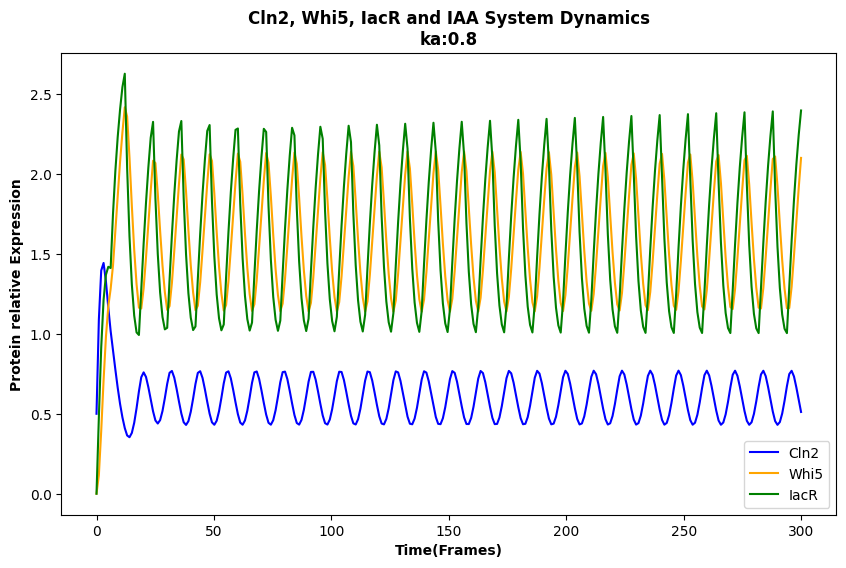

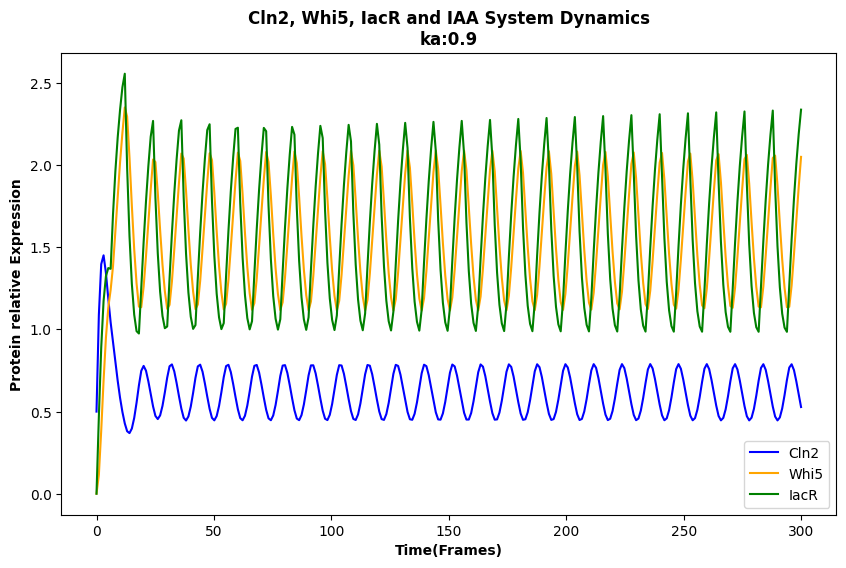

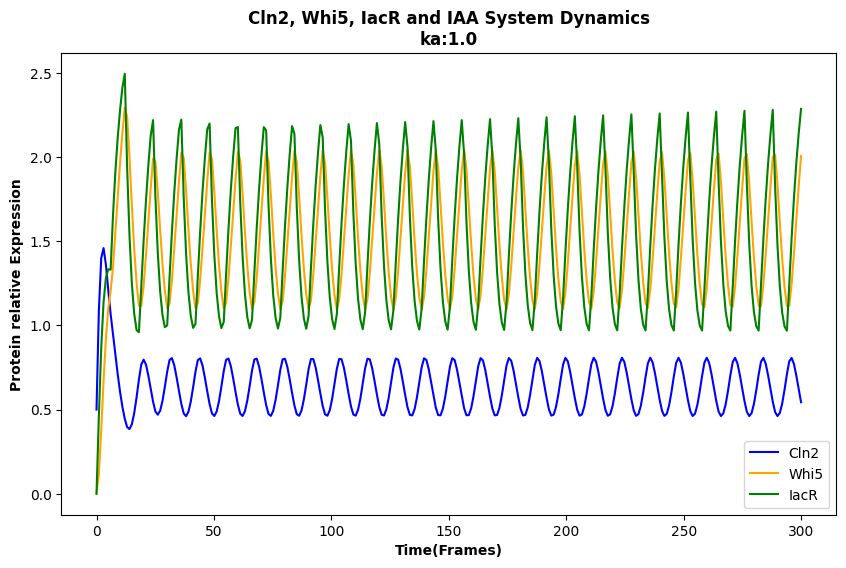

In [ ]:
#Define the function which contains the set of ordinary differential equations to mathematically model Whi5, Cln2, IacR and IAA interaction

def four_component_second(y, t, k1, k2, k3, k4, k5, km, ka, S, p, square_wave_period, phase_shift):

    #Compute the auxin signalling
    A = 0.5 * (np.sign(np.sin(2 * np.pi * t / square_wave_period)) + 1)

    #Start defining the ODEs
    C, W, I= y

    dCdt = k1 * S / (1 + (W ** p)) - k2 * C
    dIdt = k3 * C / (1 + (I * ka)) - k4  * I * A
    dWdt = k5 * (I - W)


    return [dCdt, dWdt, dIdt]

# Define the function parameters
k1, k2, k3, k4, k5, km, ka, S, p, square_wave_period = [1.0, 0.5, 0.8, 0.3, 0.6, 0.1, 0.2, 1.0, 2.0, 12]
phase_shift = np.pi / 5

# Define the time points to evaluate the solution and the initial conditions y0=[C0, W0, I0, A0]
t = np.linspace(0, 300, 300)
y0 = [0.5, 0.0, 0.0]

# Solve the function taking into account different values of ka, the ode system is solved using the odeint function

for ka in np.linspace(0, 1, 11):

    sol = odeint(four_component_second, y0, t, args=(k1, k2, k3, k4, k5, km, ka, S, p, square_wave_period, phase_shift))

    # Extract the solutions for C, W, I, IAA
    C = sol[:, 0]
    W = sol[:, 1]
    I = sol[:, 2]

    # Plot the results

    plt.figure(figsize=(10, 6)) #set figure size

    plt.plot(t, C, label='Cln2', c='blue')
    plt.plot(t, W, label='Whi5', c='orange')
    plt.plot(t, I, label='IacR', c='green')

    plt.ylabel('Protein relative Expression', weight='bold')
    plt.xlabel('Time(Frames)', weight='bold')

    plt.title('Cln2, Whi5, IacR and IAA System Dynamics\nka:{}'.format(ka), weight='bold')

    plt.legend()

    plt.show()

##### **Third Equation**

$\frac{dC}{dt} = \frac{k1 \cdot S}{1 + W^p} - k2 \cdot C^2$


$\frac{dI}{dt} = \frac{k3 \cdot C^3}{1 + I \cdot ka} - k4 \cdot I$


$\frac{dW}{dt} = k5 \cdot \left(\frac{I}{1 + \text{par} \cdot A} - W^2\right)$


$\frac{dA}{dt} = \sin\left(\frac{2 \pi t}{\text{square_wave_period}} + \text{phase_shift}\right) \cdot 0.5$

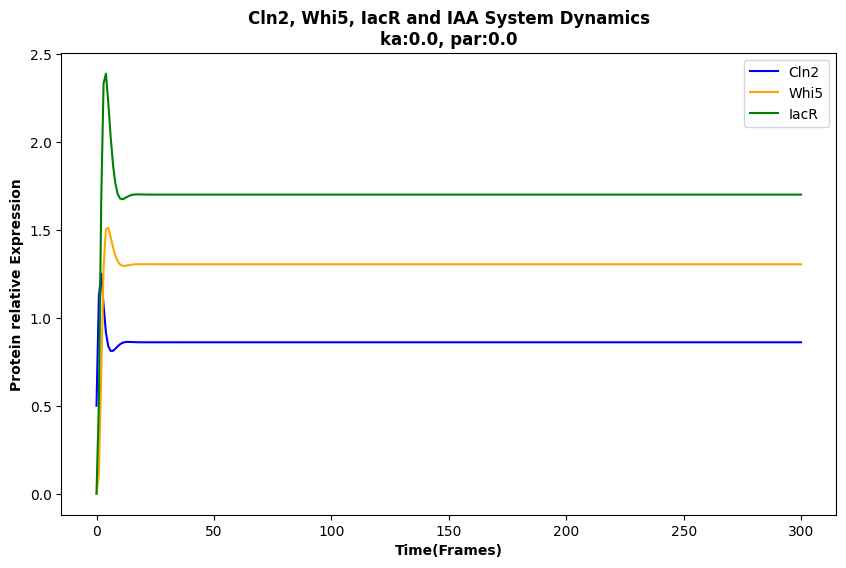

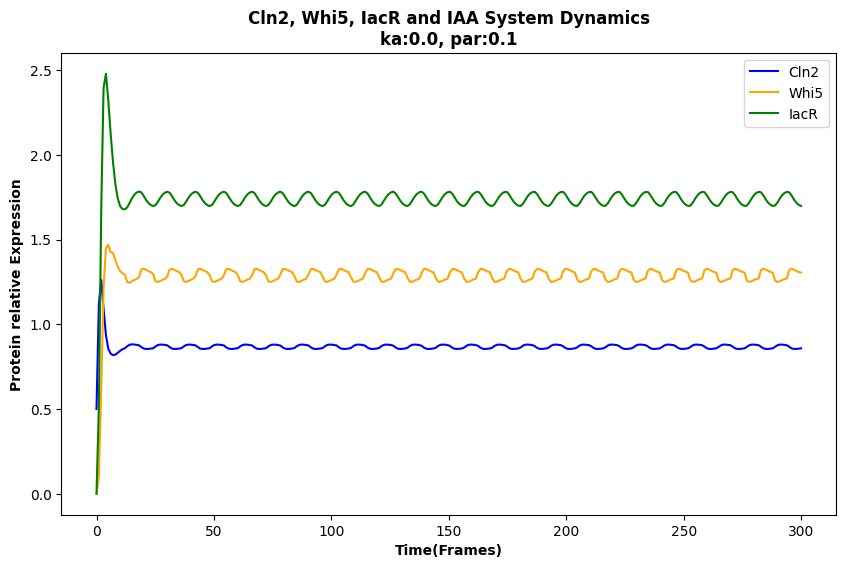

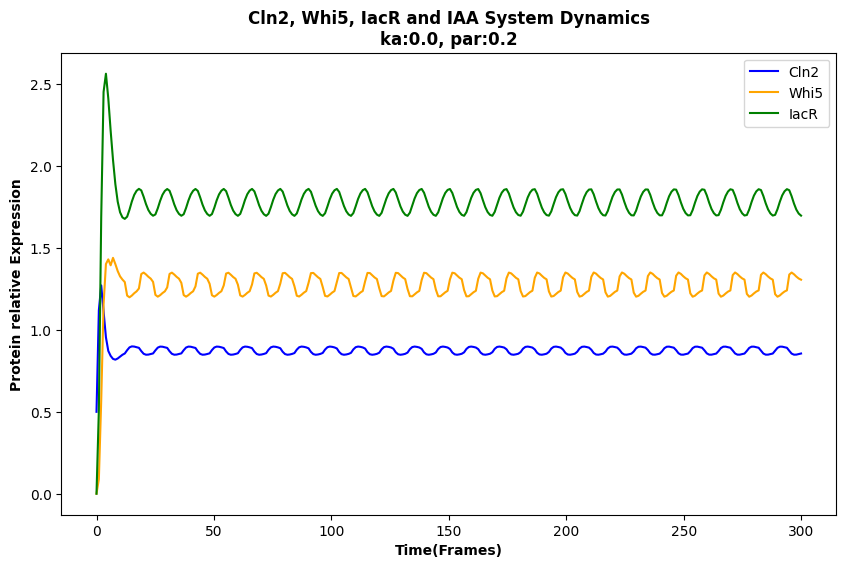

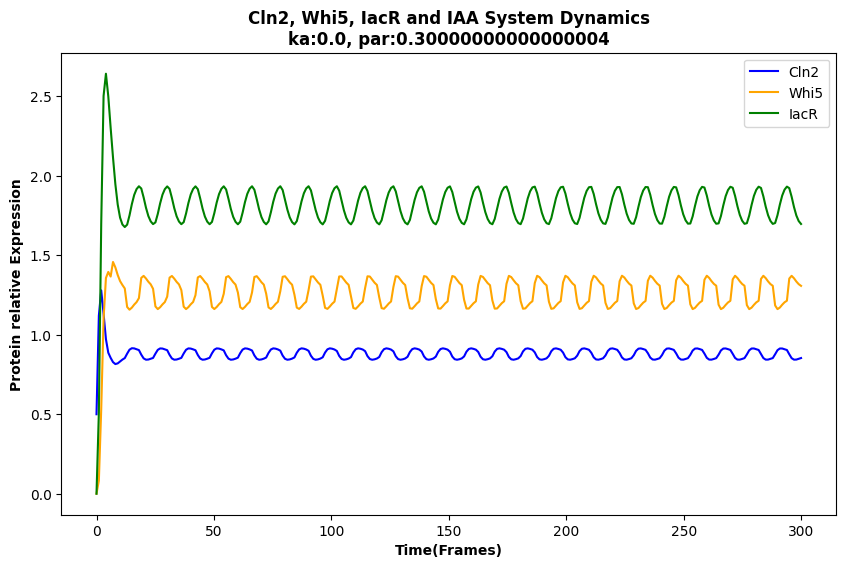

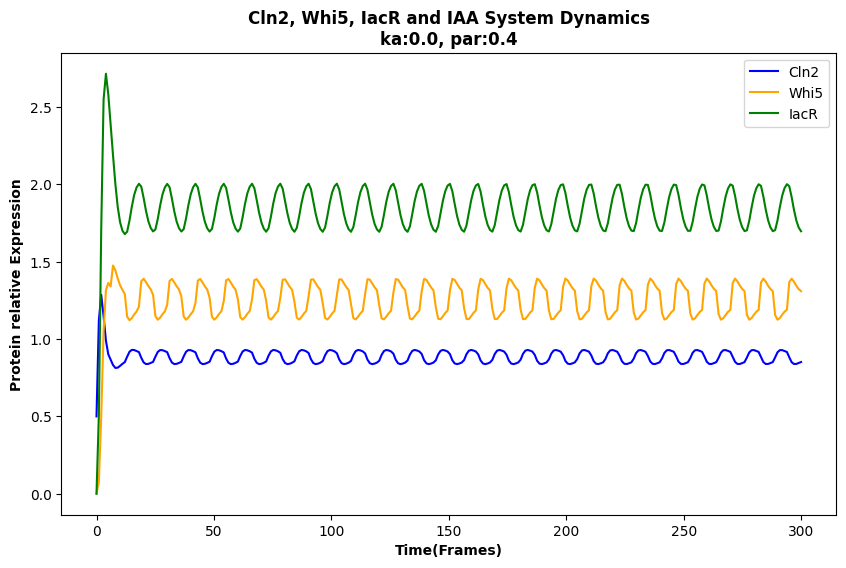

...

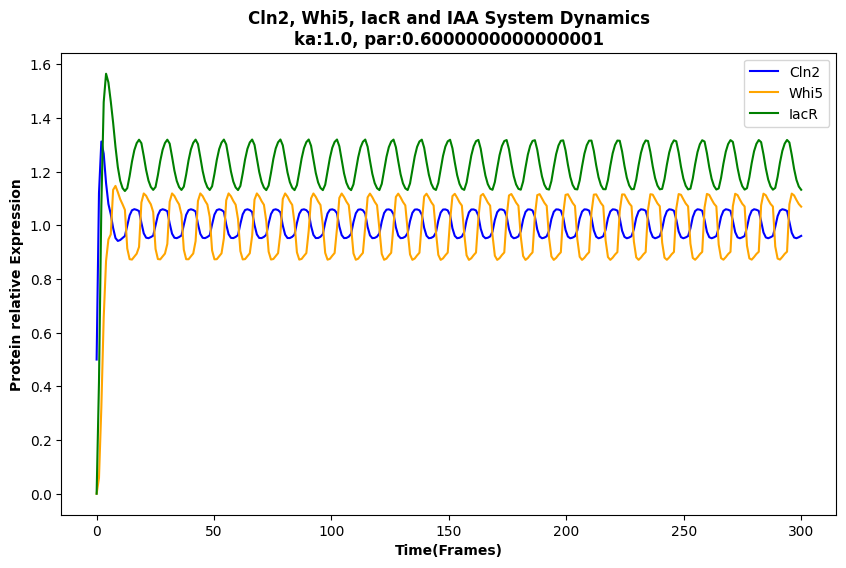

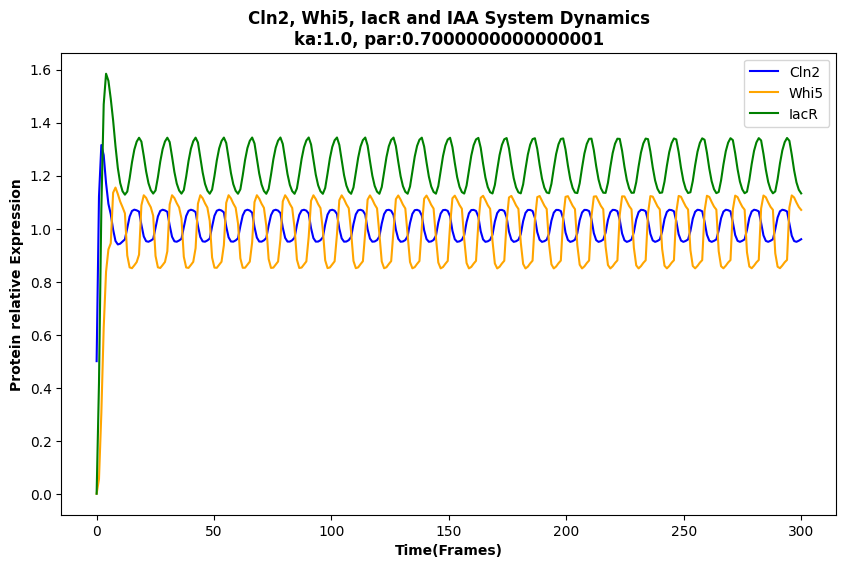

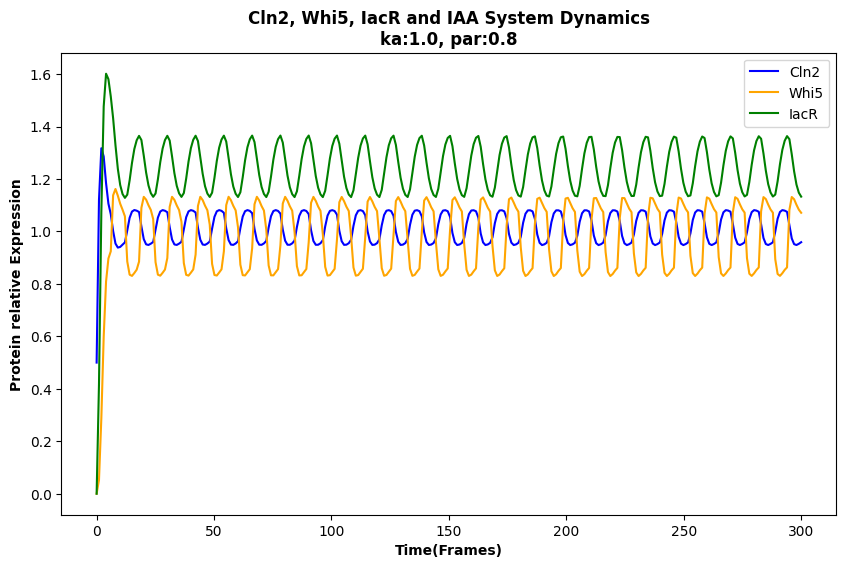

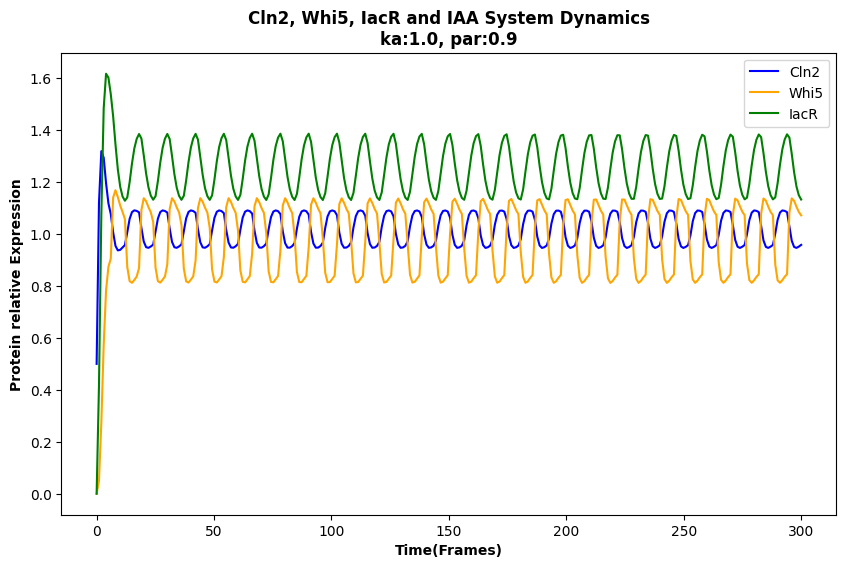

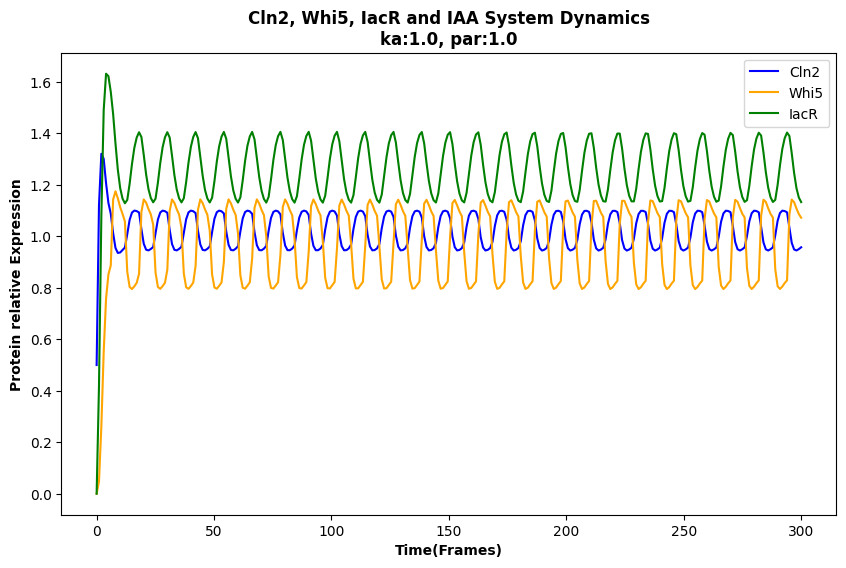

In [ ]:
#Define the function which contains the set of ordinary differential equations to mathematically model Whi5, Cln2, IacR and IAA interaction
def four_component_third(y, t, k1, k2, k3, k4, k5, ka, S, p, square_wave_period, par, phase_shift):

    #Compute the auxin signalling
    A = 0.5 * (np.sign(np.sin(2 * np.pi * t / square_wave_period)) + 1)

    #Start defining the ODEs
    C, W, I= y

    dCdt = k1 * S / (1 + (W ** p)) - k2 * C**2
    dIdt = k3 * C**3 / (1 + (I * ka)) - k4 * I
    dWdt = k5 * (I / (1 + par * A) - W**2)


    return [dCdt, dWdt, dIdt]

# Define the function parameters
k1, k2, k3, k4, k5, ka, S, p, square_wave_period, par = [1, 0.5, 0.8, 0.3, 0.6, 0.2, 1.0, 2.0, 12.0, 0.5]
phase_shift = np.pi / 4

# Define the time points to evaluate the solution and the initial conditions y0=[C0, W0, I0, A0]
t = np.linspace(0, 300, 300)
y0 = [0.5, 0.0, 0.0]


# Solve the function taking into account different values of ka and par, the ode system is solved using the odeint function
for ka in np.linspace(0,1,11):
  for par in np.linspace(0,1,11):
    sol = odeint(four_component_third, y0, t, args=(k1, k2, k3, k4, k5, ka, S, p, square_wave_period, par, phase_shift))

    # Extract the solutions for C, W, I, IAA
    C = sol[:, 0]
    W = sol[:, 1]
    I = sol[:, 2]

    # Plot the results

    plt.figure(figsize=(10, 6)) # set figure size

    plt.plot(t, C, label='Cln2', c='blue')
    plt.plot(t, W, label='Whi5', c='orange')
    plt.plot(t, I, label='IacR', c='green')

    plt.ylabel('Protein relative Expression', weight='bold')
    plt.xlabel('Time(Frames)', weight='bold')

    plt.title('Cln2, Whi5, IacR and IAA System Dynamics\nka:{}, par:{}'.format(ka, par), weight='bold')

    plt.legend()

    plt.show()


#### 5-COMPONENT, ADDING THE PMP

In [ ]:
# Define the system of differential equations
def system(y, t, k1, k2, k3, k4, k5, p, ka, par, square_wave_period, phase_shift, k6, kd, F, gk, Vk0, gE, ck, cl, Vl0, ge, gl, at, gt):

    #Compute the auxin signalling
    A = 0.5 * (np.sign(np.sin(2 * np.pi * t / square_wave_period)) + 1)

    #Start defining the ODEs

    C, I, W, n, E, V, T = y

    # Compute the signaling equations
    dCdt = k1 * S / (1 + (W ** p)) - k2 * C**2
    dIdt = k3 * C**3 / (1 + (I * ka)) - k4 * I
    dWdt = k5 * (I / (1 + par * A) - W**2)

    # Compute the PMP equations
    dndt = k6 * (I / (1 + par * A) - kd * n)
    dEdt = F * gk * (n**4) * (V - (Vk0 + ck * E)) * gE * E
    dVdt = -gk * (n ** 4) * (V - (Vk0 + ck * E)) - gl * (V - (Vl0 + cl * E))
    dTdt = at * ((Vl0 + cl * E) - V) - gt * T

    return [dCdt, dIdt, dWdt, dndt, dEdt, dVdt, dTdt]

# Define the initial conditions
y0 = [0.5, 0, 0, 0, 0, 0, 0]  # Replace C0, I0, W0, A0, n0, E0, V0, T0 with the actual initial values

k1, k2, k3, k4, k5, k6, ka, S, p, square_wave_period, par, kd  = [1, 0.5, 0.8, 0.3, 0.6, 2.0, 0.2, 1.0, 2.0, 12.0, 0.5, 1.3]
F, gk, Vk0, gE, ck, cl, Vl0, ge, gl, at, gt = [5.6, 30, -380, 10, 1, 8, -156, 10, 0.2, 1, 4]
phase_shift=0

# Define the time points for integration
t = np.linspace(0, 300, 300)  # Adjust the time range and number of points as needed

# Solve the system of differential equations
solution = odeint(system, y0, t, args=(k1, k2, k3, k4, k5, p, ka, par, square_wave_period, phase_shift, k6, kd, F, gk, Vk0, gE, ck, cl, Vl0, ge, gl, at, gt))


In [ ]:
# Extract the solutions for C, W, I, IAA
C = solution[:, 0]
I = solution[:, 1]
W = solution[:, 2]

n = solution[:, 3]
E = solution[:, 4]
V = solution[:, 5]
T = solution[:, 6]


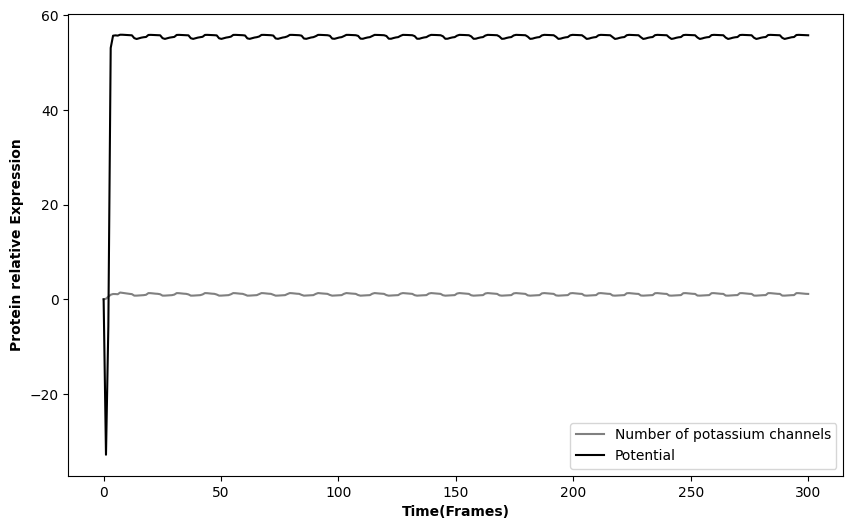

In [ ]:
# Plot the results
plt.figure(figsize=(10, 6)) # set figure size

#plt.plot(t, V, label='PMP', c='red')
plt.plot(t, n, label='Number of potassium channels', c='grey')
#plt.plot(t, W, label='Whi5', c='orange')
plt.plot(t, T, label='Potential', c='black')
#plt.plot(t, C, label='Cln2', c='blue')
#plt.plot(t, I, label='IacR', c='green')

plt.ylabel('Protein relative Expression', weight='bold')
plt.xlabel('Time(Frames)', weight='bold')
plt.legend()

plt.show()